In [1]:
import numpy as np
from matplotlib import pyplot as plt
from matplotlib import cm

from tensorflow.keras import models
from tensorflow.keras.preprocessing.image import load_img
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.applications.vgg16 import preprocess_input, decode_predictions


model = VGG16(weights='imagenet', include_top=True) #Load alredy pre-trained model
model.summary() #Print a list of layers with all the details

553467096/553467096 ━━━━━━━━━━━━━━━━━━━━ 7s 0us/step


Model: "vgg16"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 224, 224, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_conv1 (Conv2D)                │ (None, 224, 224, 64)        │           1,792 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_conv2 (Conv2D)                │ (None, 224, 224, 64)        │          36,928 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_pool (MaxPooling2D)           │ (None, 112, 112, 64)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_conv1 (Conv2D)                │ (None, 112, 112, 128)       │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_conv2 (Conv2D)                │ (None, 112, 112, 128)       │         147,584 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_pool (MaxPooling2D)           │ (None, 56, 56, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv1 (Conv2D)                │ (None, 56, 56, 256)         │         295,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv2 (Conv2D)                │ (None, 56, 56, 256)         │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv3 (Conv2D)                │ (None, 56, 56, 256)         │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_pool (MaxPooling2D)           │ (None, 28, 28, 256)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv1 (Conv2D)                │ (None, 28, 28, 512)         │       1,180,160 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv2 (Conv2D)                │ (None, 28, 28, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv3 (Conv2D)                │ (None, 28, 28, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_pool (MaxPooling2D)           │ (None, 14, 14, 512)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv1 (Conv2D)                │ (None, 14, 14, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv2 (Conv2D)                │ (None, 14, 14, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv3 (Conv2D)                │ (None, 14, 14, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_pool (MaxPooling2D)           │ (None, 7, 7, 512)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 25088)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ fc1 (Dense)                          │ (None, 4096)                │     102,764,544 │
├──────────────────────────────────────┼─────────────────────────────┼──────────────

 Total params: 138,357,544 (527.79 MB)

 Trainable params: 138,357,544 (527.79 MB)

 Non-trainable params: 0 (0.00 B)

In [2]:
from google.colab import files
uploaded = files.upload()

!mkdir -p images/
!mv *.jpg images/
!mv *.jpeg images/

Saving helicopter.jpg to helicopter.jpg
Saving rose.jpeg to rose.jpeg
Saving eagle.jpg to eagle.jpg


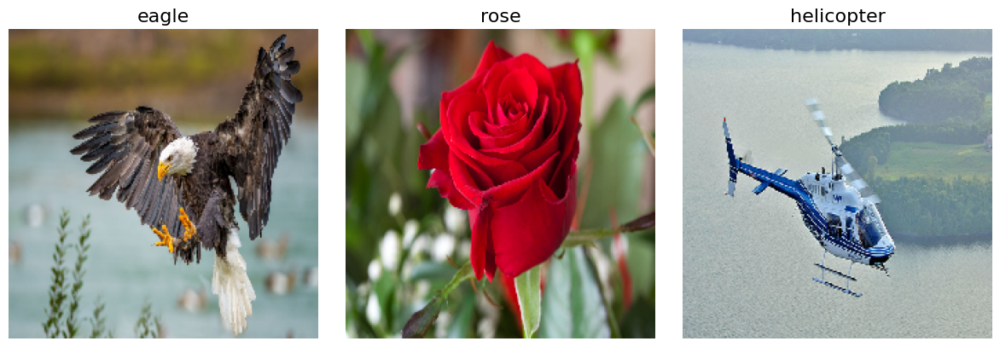

In [4]:
# Assign image titles for your images
image_titles = ['eagle', 'rose', 'helicopter']

# Load images and reshape them
img1 = load_img('/content/images/eagle.jpg', target_size=(224, 224))
img2 = load_img('/content/images/rose.jpeg', target_size=(224, 224))
img3 = load_img('/content/images/helicopter.jpg', target_size=(224, 224))
#We resize the images into size 224 x 224, as the model prefers those sizes. However, if your images are smaller, you can change those values a little bit.

# Convert them to a Numpy array
images = np.asarray([np.array(img1), np.array(img2), np.array(img3)])

# Preparing input data for VGG16
X = preprocess_input(images)

# Rendering
f, ax = plt.subplots(nrows=1, ncols=3, figsize=(12, 4))
for i, title in enumerate(image_titles):
    ax[i].set_title(title, fontsize=16)
    ax[i].imshow(images[i])
    ax[i].axis('off')
plt.tight_layout()
plt.show()

In [5]:
# Predict the output (probabilities) of the layer, corresponding to an image
preds = model.predict(X)
best_class = np.argmax(preds, axis=1)
print('Best class:', best_class)

print('Predicted:', decode_predictions(preds, top=3)[0]) #Decode prediction based on Imagenet dataset dictionary. Each umerical class is assigned to a real-life label
print('Predicted:', decode_predictions(preds, top=3)[1])
print('Predicted:', decode_predictions(preds, top=3)[2])

1/1 ━━━━━━━━━━━━━━━━━━━━ 5s 5s/step
Best class: [ 22  94 701]
35363/35363 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step
Predicted: [('n01614925', 'bald_eagle', 0.9953343), ('n01608432', 'kite', 0.0031176452), ('n01616318', 'vulture', 0.0013463309)]
Predicted: [('n01833805', 'hummingbird', 0.34240106), ('n03991062', 'pot', 0.088291906), ('n12620546', 'hip', 0.07922984)]
Predicted: [('n03888257', 'parachute', 0.29236093), ('n04552348', 'warplane', 0.24640046), ('n02690373', 'airliner', 0.15168773)]


In [6]:
!pip install tf_keras_vis

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 52.5/52.5 kB 2.8 MB/s eta 0:00:00


In [7]:
from tf_keras_vis.gradcam import Gradcam
from tf_keras_vis.gradcam_plus_plus import GradcamPlusPlus
from tf_keras_vis.scorecam import Scorecam
from tf_keras_vis.saliency import Saliency
from tf_keras_vis.utils.model_modifiers import ReplaceToLinear
from tf_keras_vis.utils.scores import CategoricalScore

In [8]:
def visualise_heatmap(map, image=None):
  f, ax = plt.subplots(nrows=1, ncols=3, figsize=(12, 4))
  for i, title in enumerate(image_titles):
      heatmap = np.uint8(cm.jet(map[i])[..., :3] * 255)
      ax[i].set_title(title, fontsize=16)
      ax[i].imshow(images[i])
      ax[i].imshow(heatmap, cmap='jet', alpha=0.5)
      ax[i].axis('off')
  plt.tight_layout()
  plt.show()

# GradCAM

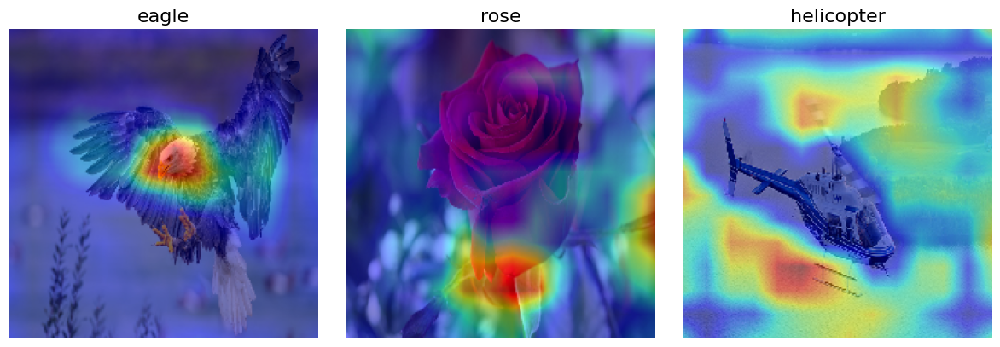

In [9]:
replace2linear = ReplaceToLinear()
score = CategoricalScore(list(best_class))

gradcam = Gradcam(model,
                  model_modifier=replace2linear,
                  clone=True)

cam = gradcam(score,
              X,
              penultimate_layer=-1)

visualise_heatmap(cam)

# GradCAM++

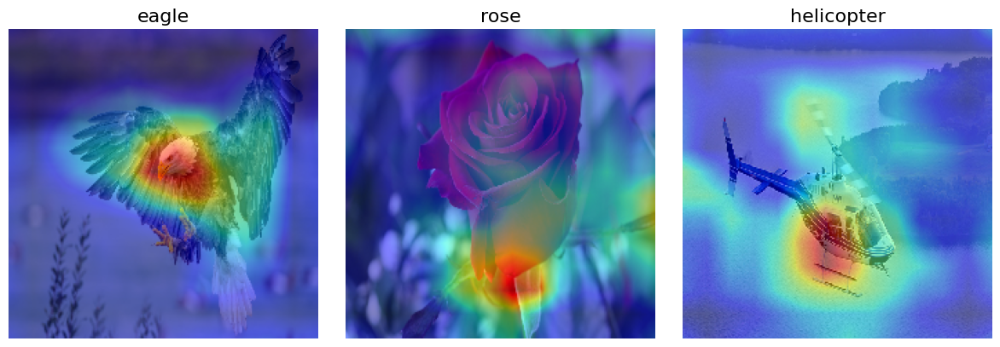

In [10]:
gradcam = GradcamPlusPlus(model,
                          model_modifier=replace2linear,
                          clone=True)

cam = gradcam(score,
              X,
              penultimate_layer=-1)

visualise_heatmap(cam)

ScoreCAM

48/48 ━━━━━━━━━━━━━━━━━━━━ 19s 116ms/step


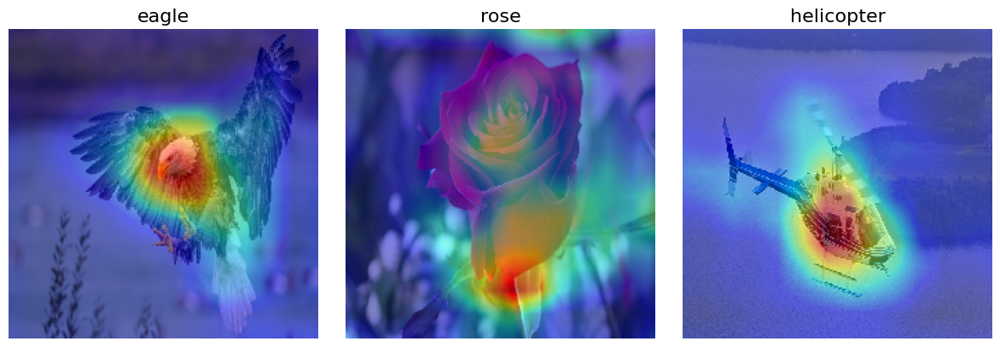

In [11]:
scorecam = Scorecam(model)
cam = scorecam(score, X, penultimate_layer=-1)
visualise_heatmap(cam)

Saliency Maps

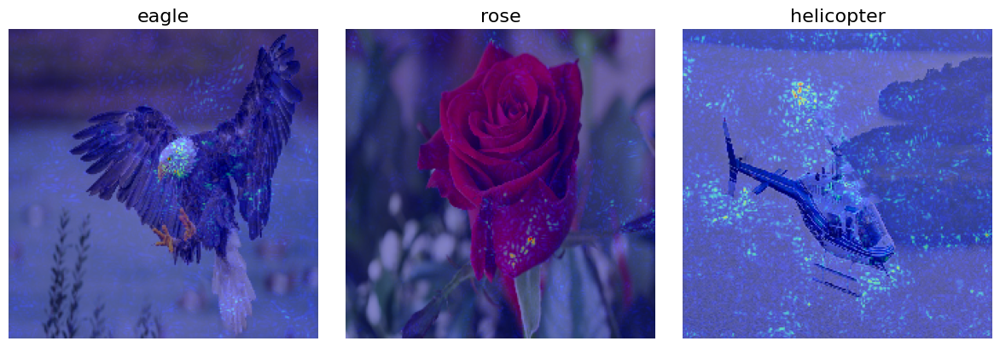

In [12]:
saliency = Saliency(model, model_modifier=replace2linear, clone=True)
saliency_map = saliency(score, X)
visualise_heatmap(saliency_map)

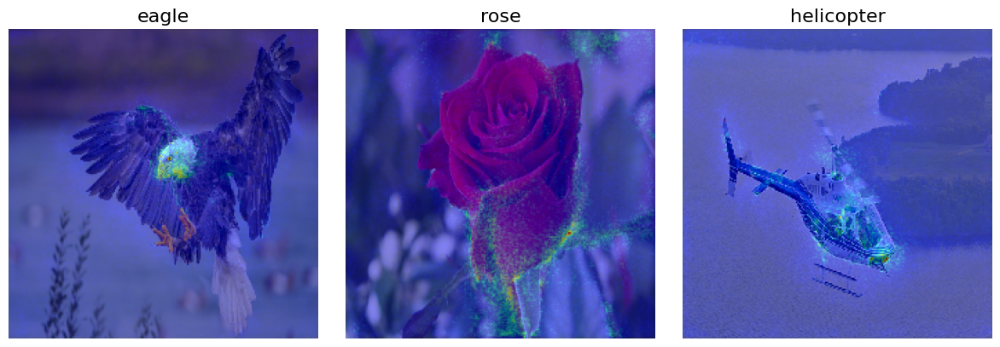

In [13]:
saliency_map = saliency(score, X, smooth_samples=20, smooth_noise=0.20)
visualise_heatmap(saliency_map)

Task 1 You can test the performance of all these methods on images that have more than one object. Check if the network classifies the image based on just one object, or all of them.

Task 2 You can visualise a heatmap that corresponds to a different class than the class with the highest probability - for example, the second best, 5th best, 10th best etc.

Task 3 You can test the performance on an image with two contradictory objects, such as dog and cat.

In [14]:
from google.colab import files
uploaded = files.upload()

!mkdir -p images/
!mv *.jpg images/
!mv *.jpeg images/

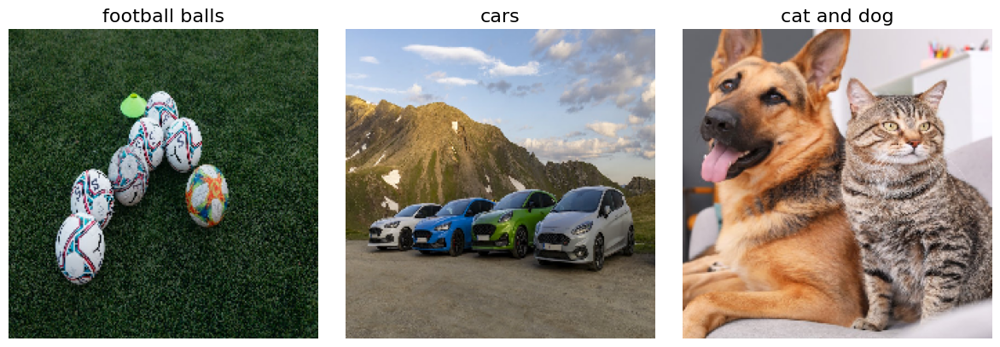

In [15]:
# Assign image titles for your images
image_titles = ['football balls', 'cars', 'cat and dog']

# Load images and reshape them
img1 = load_img('/content/images/football_balls.jpeg', target_size=(224, 224))
img2 = load_img('/content/images/cars.jpeg', target_size=(224, 224))
img3 = load_img('/content/images/cat_and_dog.jpg', target_size=(224, 224))
#We resize the images into size 224 x 224, as the model prefers those sizes. However, if your images are smaller, you can change those values a little bit.

# Convert them to a Numpy array
images = np.asarray([np.array(img1), np.array(img2), np.array(img3)])

# Preparing input data for VGG16
X = preprocess_input(images)

# Rendering
f, ax = plt.subplots(nrows=1, ncols=3, figsize=(12, 4))
for i, title in enumerate(image_titles):
    ax[i].set_title(title, fontsize=16)
    ax[i].imshow(images[i])
    ax[i].axis('off')
plt.tight_layout()
plt.show()

In [16]:
# Predict the output (probabilities) of the layer, corresponding to an image
preds = model.predict(X)

sorted_indices = np.argsort(preds, axis=1)[:, ::-1]
best_class = sorted_indices[:, 0] # the best class
second_best_class = sorted_indices[:, 1] # 2nd best class
fifth_best_class = sorted_indices[:, 4] # 5th best class
tenth_best_class = sorted_indices[:, 9] # 10th best class

print('Best class:', best_class)
print('Second best class:', second_best_class)
print('Fifth class:', best_class)
print('Tenth best class:', second_best_class)

#Decode prediction based on Imagenet dataset dictionary. Each umerical class is assigned to a real-life label
for i in range(len(X)):
    print(f'Image title: {image_titles[i]}')
    print('  Predicted top 1:', decode_predictions(preds, top=3)[i][0])
    print('  Predicted top 2:', decode_predictions(preds, top=3)[i][1])
    print('  Predicted top 3:', decode_predictions(preds, top=3)[i][2])


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
Best class: [805 656 235]
Second best class: [697 757 281]
Fifth class: [805 656 235]
Tenth best class: [697 757 281]
Image title: football balls
  Predicted top 1: ('n04254680', 'soccer_ball', 0.98544055)
  Predicted top 2: ('n03877472', 'pajama', 0.0038882801)
  Predicted top 3: ('n03379051', 'football_helmet', 0.003597323)
Image title: cars
  Predicted top 1: ('n03770679', 'minivan', 0.62184584)
  Predicted top 2: ('n04065272', 'recreational_vehicle', 0.1188015)
  Predicted top 3: ('n03792972', 'mountain_tent', 0.07957425)
Image title: cat and dog
  Predicted top 1: ('n02106662', 'German_shepherd', 0.04438191)
  Predicted top 2: ('n02123045', 'tabby', 0.019959858)
  Predicted top 3: ('n02124075', 'Egyptian_cat', 0.0186243)


In [17]:
def visualise_heatmap(map, image=None):
  f, ax = plt.subplots(nrows=1, ncols=3, figsize=(12, 4))
  for i, title in enumerate(image_titles):
      heatmap = np.uint8(cm.jet(map[i])[..., :3] * 255)
      ax[i].set_title(title, fontsize=16)
      ax[i].imshow(images[i])
      ax[i].imshow(heatmap, cmap='jet', alpha=0.5)
      ax[i].axis('off')
  plt.tight_layout()
  plt.show()

# GradCam

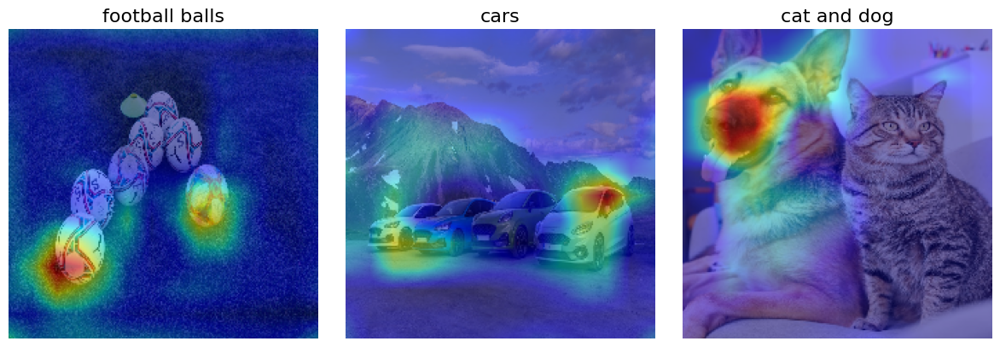

In [18]:
replace2linear = ReplaceToLinear()
score = CategoricalScore(list(best_class))

gradcam = Gradcam(model,
                  model_modifier=replace2linear,
                  clone=True)

cam = gradcam(score,
              X,
              penultimate_layer=-1)

visualise_heatmap(cam)

# GradCam++

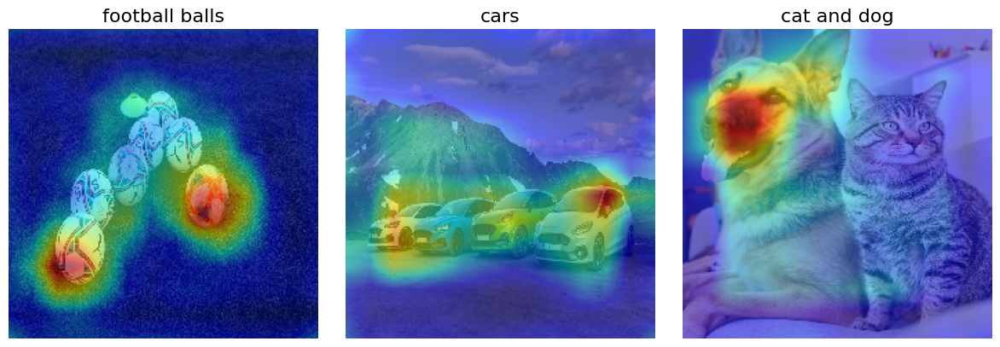

In [19]:
gradcam = GradcamPlusPlus(model,
                          model_modifier=replace2linear,
                          clone=True)

cam = gradcam(score,
              X,
              penultimate_layer=-1)

visualise_heatmap(cam)

# ScoreCAM

48/48 ━━━━━━━━━━━━━━━━━━━━ 5s 116ms/step


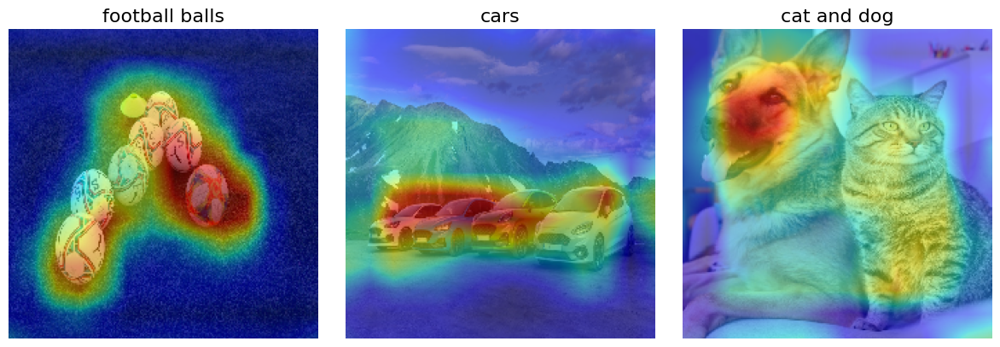

In [20]:
scorecam = Scorecam(model)
cam = scorecam(score, X, penultimate_layer=-1)
visualise_heatmap(cam)

# Saliency Maps

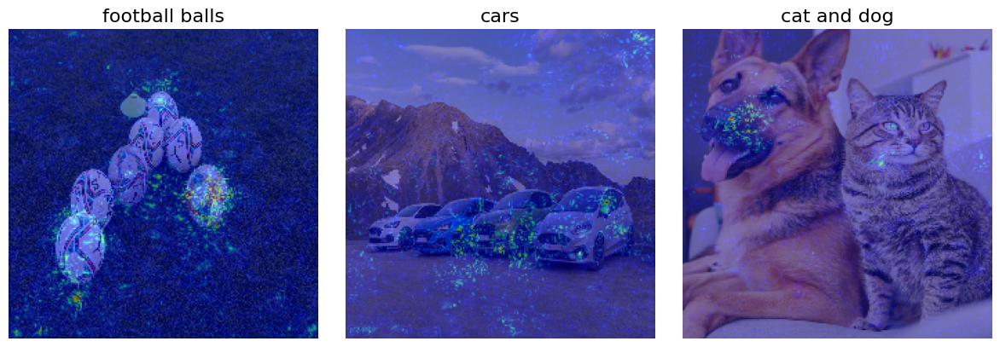

In [21]:
saliency = Saliency(model, model_modifier=replace2linear, clone=True)
saliency_map = saliency(score, X)
visualise_heatmap(saliency_map)

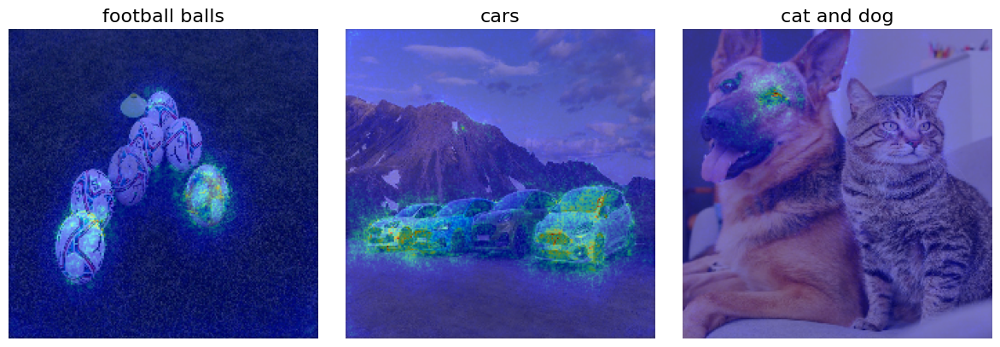

In [22]:
saliency_map = saliency(score, X, smooth_samples=20, smooth_noise=0.20)
visualise_heatmap(saliency_map)

# Visualizing intermediate *activations*

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 565ms/step
['input_layer', 'block1_conv1', 'block1_conv2', 'block1_pool', 'block2_conv1', 'block2_conv2', 'block2_pool', 'block3_conv1', 'block3_conv2', 'block3_conv3', 'block3_pool', 'block4_conv1', 'block4_conv2', 'block4_conv3', 'block4_pool', 'block5_conv1', 'block5_conv2', 'block5_conv3', 'block5_pool', 'flatten', 'fc1', 'fc2']


<ipython-input-31-c500eacf7635>:23: RuntimeWarning: invalid value encountered in divide
  channel_image /= np.max(channel_image)


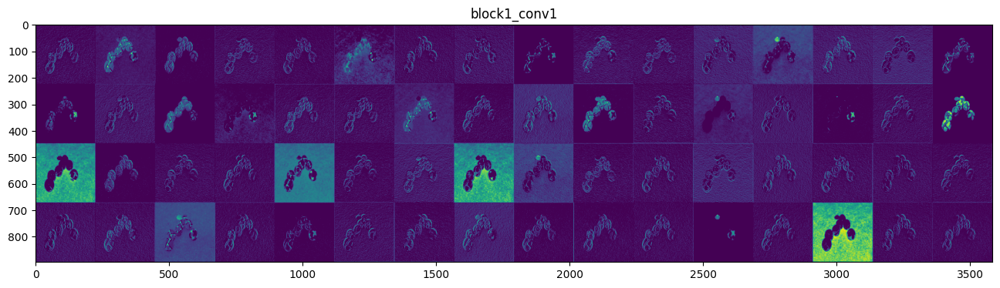

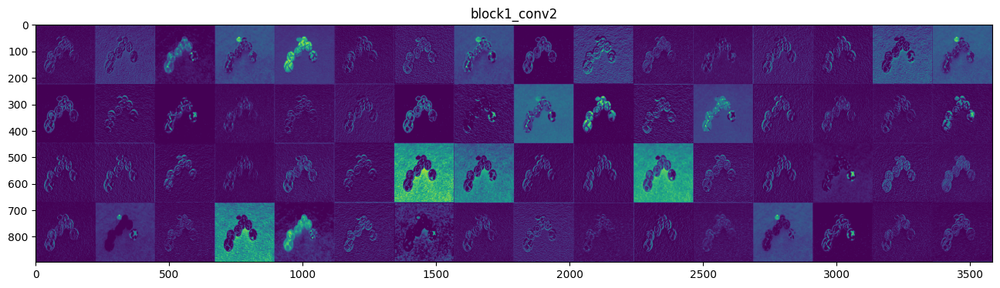

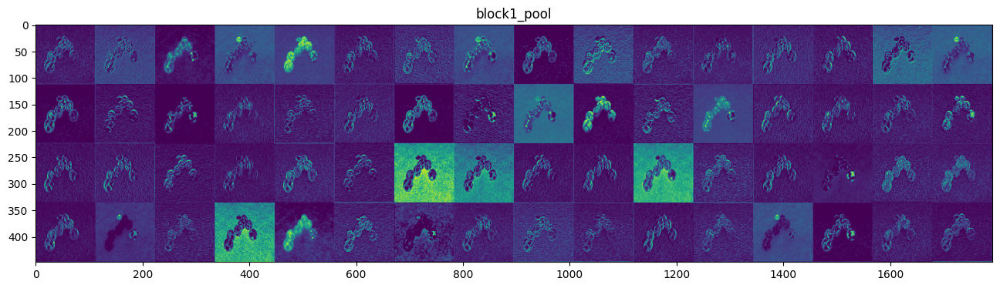

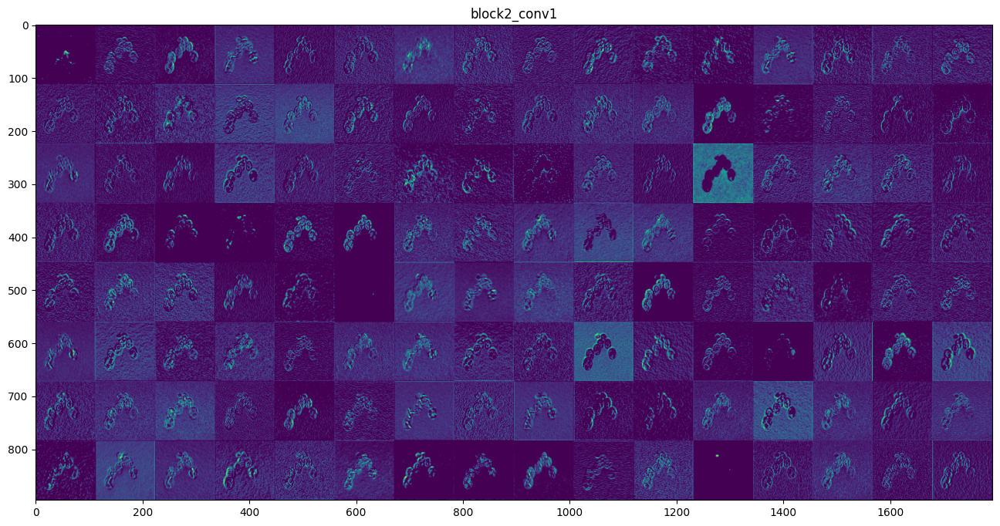

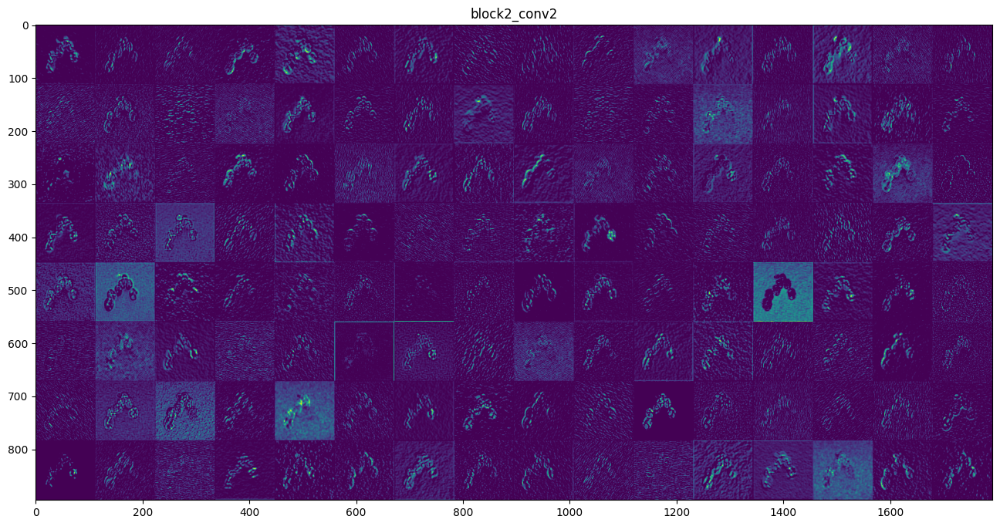

...

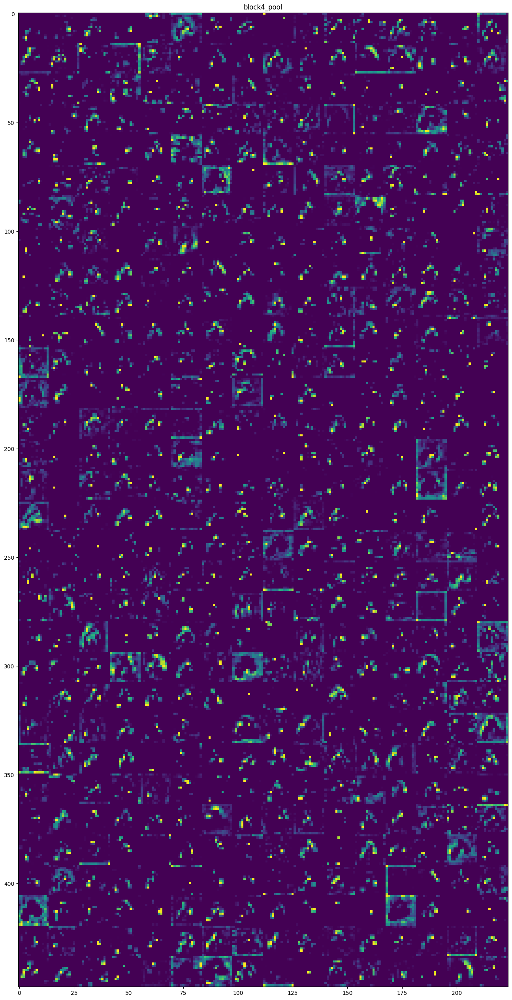

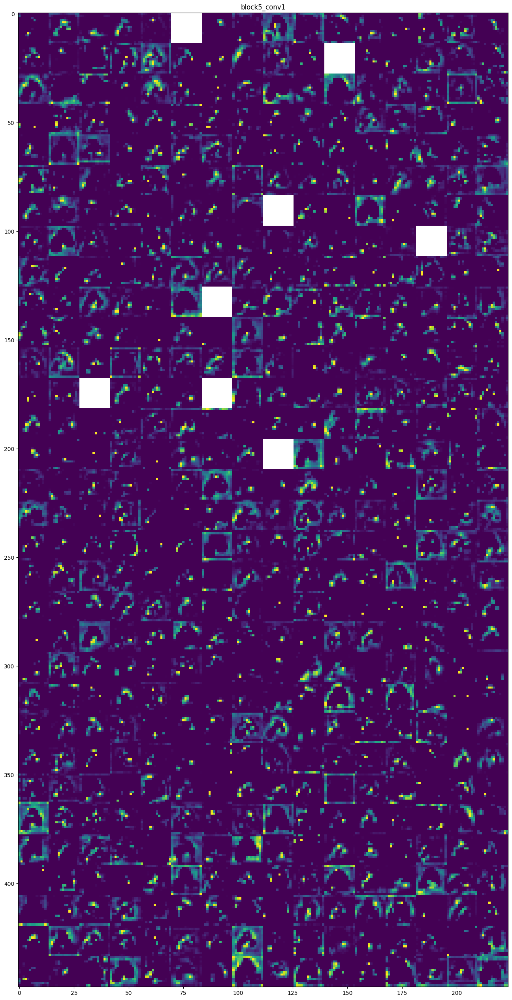

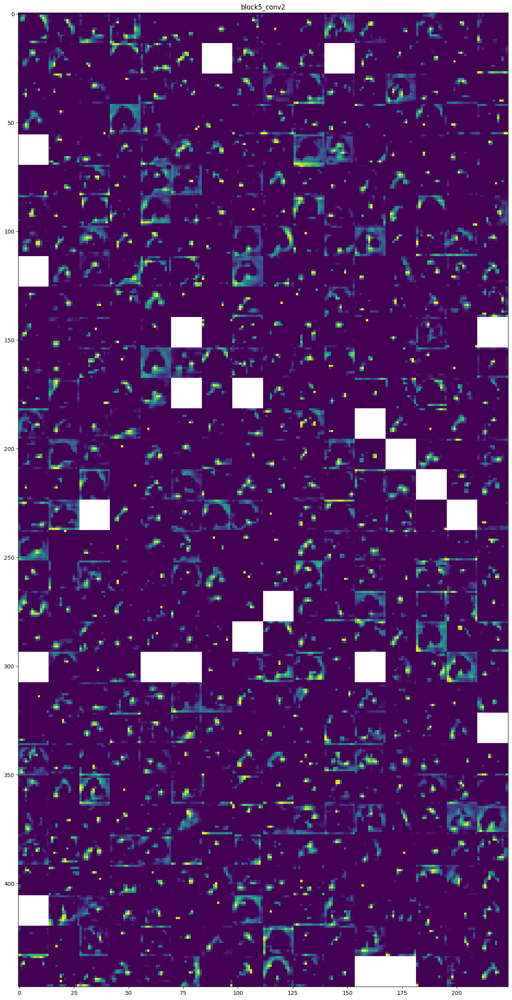

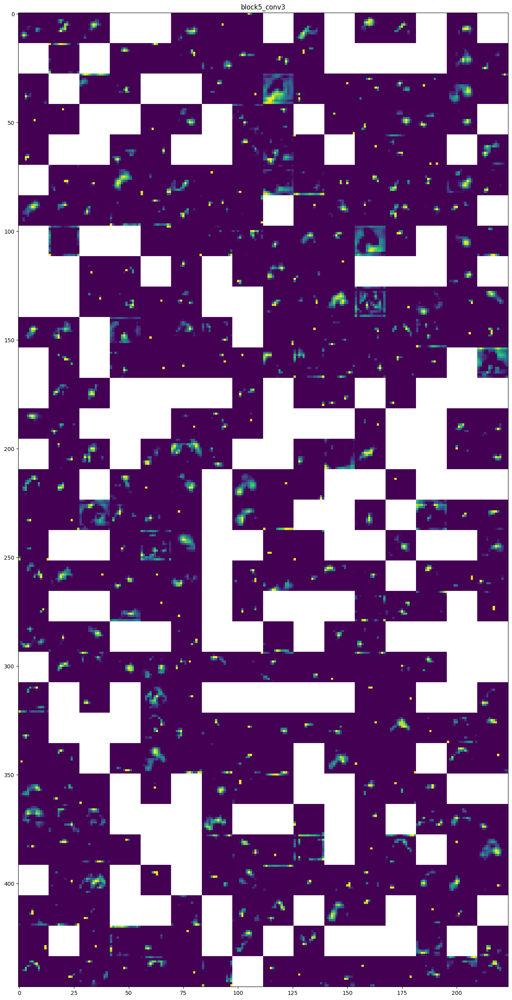

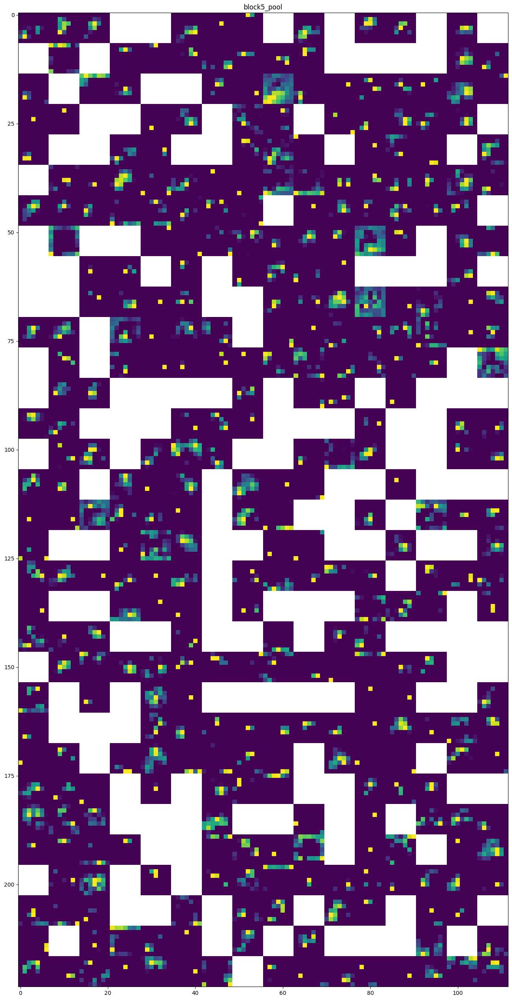

In [31]:
layer_outputs = [layer.output for layer in model.layers] #Loop through the model defined in the beginning to access outputs of individual layers
activation_model = models.Model(model.input, layer_outputs)
X_reshaped = X[0].reshape(1, 224, 224, 3) #take one image and reshape it into size (1,224,224,3)
activations = activation_model.predict(X_reshaped ) #use the predict function on the activation model to get the intermediate activations

layer_names = []
for layer in model.layers[:-1]:
    layer_names.append(layer.name)

print(layer_names)

images_per_row = 16
for layer_name, layer_activation in zip(layer_names, activations):
    #if layer_name == 'block3_pool': # Specify the name of the layer that you want to see. Choose one name from the model summary we printed in the beginning
    if layer_name not in (layer_names[0], layer_names[-1], layer_names[-2], layer_names[-3]):
      number_of_feature_maps = layer_activation.shape[-1]
      feature_map_shape = layer_activation.shape[1]
      n_cols = number_of_feature_maps // images_per_row
      display_grid = np.zeros((feature_map_shape * n_cols, images_per_row * feature_map_shape))
      for col in range(n_cols):
          for row in range(images_per_row):
              channel_image = layer_activation[0,:, :, col * images_per_row + row]
              channel_image /= np.max(channel_image)
              display_grid[col * feature_map_shape : (col + 1) * feature_map_shape, row * feature_map_shape : (row + 1) * feature_map_shape] = channel_image
      scale = 1. / feature_map_shape
      plt.figure(figsize=(scale * display_grid.shape[1], scale * display_grid.shape[0]))
      plt.title(f"{layer_name}")
      plt.imshow(display_grid, aspect='auto', cmap='viridis')